# Домашнее задание

Всего у вас 2 домашних задания:

### 1) Бинарная классификация на примере детекции фрода на кредитных картах (6 баллов)
(в этом файле)

### 2) Небинарная классификация на вашем датасете (6 баллов)
(тоже в этом файле)

# 1 - Бинарная классификация на примере детекции фрода на кредитных картах (суммарно 6 баллов)
У вас есть информация о множесте транзакций. Вам нужно научиться предсказывать, какие из них мошеннические, а какие нет.

### (1 балл) Считайте данные
Сами считайте и предобработайте, если надо, данные из файла creditcard.csv

In [91]:
import pandas as pd
import numpy as np
import plotly.express as px
import warnings
warnings.filterwarnings('ignore')

In [92]:
df = pd.read_csv('creditcard.csv')
df.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [93]:
df.info() # Посмотрим, все ли признаки числовые

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

In [94]:
df.isna().sum() # Посмотрим, есть ли пропуски в данных

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64

In [95]:
X = df.drop(columns=['Class'])
y = df['Class']

In [96]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

### (2 балла) Обучите несколько моделей, посмотрите на метрики.
Как модели точно возьмите LogisticRegression, KNN и константу, можете придумать еще какие-нибудь.

Как метрики точно возьмите accuracy, precision, recall, f1, roc_auc. Постройте ROC-кривую.

In [97]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score

In [98]:
#Логистическая регрессия
from sklearn.linear_model import LogisticRegression
log_reg = LogisticRegression(max_iter=1000)

log_reg.fit(X_train, y_train)
y_pred_logreg = log_reg.predict(X_test)


print('Полученные значения для модели Логистической регрессии:')
print('Accuracy:', round(accuracy_score(y_test, y_pred_logreg), 4))
print('Precision:', round(precision_score(y_test, y_pred_logreg), 4))
print('Recall:', round(recall_score(y_test, y_pred_logreg), 4))
print('F1:', round(f1_score(y_test, y_pred_logreg), 4))
print('Roc-auc:', round(roc_auc_score(y_test, y_pred_logreg), 4))

log_reg_scores = [round(accuracy_score(y_test, y_pred_logreg), 4), round(precision_score(y_test, y_pred_logreg), 4), 
                  round(recall_score(y_test, y_pred_logreg), 4), round(f1_score(y_test, y_pred_logreg), 4), 
                  round(roc_auc_score(y_test, y_pred_logreg), 4)]

Полученные значения для модели Логистической регрессии:
Accuracy: 0.9992
Precision: 0.8137
Recall: 0.6103
F1: 0.6975
Roc-auc: 0.805


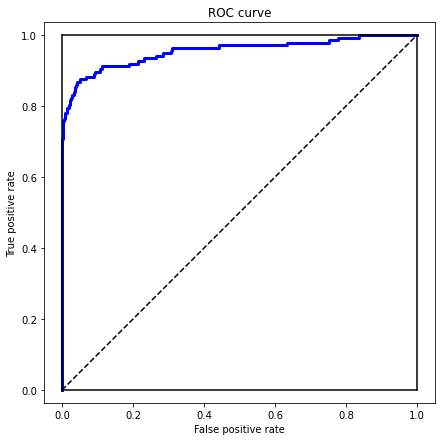

In [99]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve

y_pred_proba = log_reg.predict_proba(X_test)[:, 1]

plt.figure(figsize=(7, 7))
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
plt.plot(fpr, tpr, 'b', linewidth=3)
plt.plot([0, 1], [0, 1], 'k--')
plt.plot([0, 0], [0, 1], 'k')
plt.plot([1, 1], [0, 1], 'k')
plt.plot([0, 1], [0, 0], 'k')
plt.plot([0, 1], [1, 1], 'k')
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.xlim((0, 1))
plt.ylim((0, 1))
plt.axis('equal')
plt.title('ROC curve')
plt.show()

In [100]:
#Константа (так как почти все транзакции не мошеннические)
y_pred_const = np.zeros(len(X_test))

print('Полученные значения для модели с константой:')
print('Accuracy:', round(accuracy_score(y_test, y_pred_const), 4))
print('Precision:', round(precision_score(y_test, y_pred_const), 4))
print('Recall:', round(recall_score(y_test, y_pred_const), 4))
print('F1:', round(f1_score(y_test, y_pred_const), 4))
print('Roc-auc:', round(roc_auc_score(y_test, y_pred_const), 4))

const_scores = [round(accuracy_score(y_test, y_pred_const), 4), round(precision_score(y_test, y_pred_const), 4), 
                  round(recall_score(y_test, y_pred_const), 4), round(f1_score(y_test, y_pred_const), 4), 
                  round(roc_auc_score(y_test, y_pred_const), 4)]


Полученные значения для модели с константой:
Accuracy: 0.9984
Precision: 0.0
Recall: 0.0
F1: 0.0
Roc-auc: 0.5


In [101]:
# KNN
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(X_train, y_train)
y_pred_knn = knn.predict(X_test)

print('Полученные значения для модели KNN:')
print('Accuracy:', round(accuracy_score(y_test, y_pred_knn), 4))
print('Precision:', round(precision_score(y_test, y_pred_knn), 4))
print('Recall:', round(recall_score(y_test, y_pred_knn), 4))
print('F1:', round(f1_score(y_test, y_pred_knn), 4))
print('Roc-auc:', round(roc_auc_score(y_test, y_pred_knn), 4))

knn_scores = [round(accuracy_score(y_test, y_pred_knn), 4), round(precision_score(y_test, y_pred_knn), 4), 
                  round(recall_score(y_test, y_pred_knn), 4), round(f1_score(y_test, y_pred_knn), 4), 
                  round(roc_auc_score(y_test, y_pred_knn), 4)]

Полученные значения для модели KNN:
Accuracy: 0.9985
Precision: 1.0
Recall: 0.0441
F1: 0.0845
Roc-auc: 0.5221


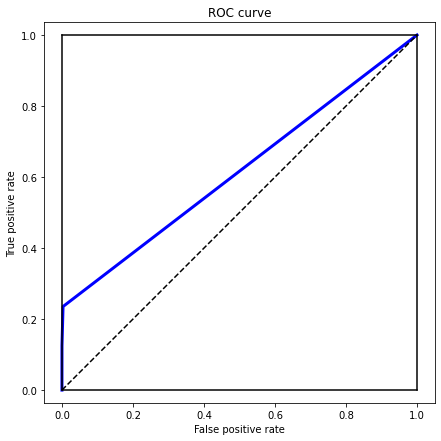

In [102]:
y_pred_proba = knn.predict_proba(X_test)[:, 1]

plt.figure(figsize=(7, 7))
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
plt.plot(fpr, tpr, 'b', linewidth=3)
plt.plot([0, 1], [0, 1], 'k--')
plt.plot([0, 0], [0, 1], 'k')
plt.plot([1, 1], [0, 1], 'k')
plt.plot([0, 1], [0, 0], 'k')
plt.plot([0, 1], [1, 1], 'k')
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.xlim((0, 1))
plt.ylim((0, 1))
plt.axis('equal')
plt.title('ROC curve')
plt.show()

In [105]:
scores_df = pd.DataFrame([log_reg_scores, const_scores, knn_scores], 
                         columns=['accuracy', 'precision', 'recall', 'f1', 'roc-auc'], index=['log-reg', 'const', 'knn'])
scores_df

,accuracy,precision,recall,f1,roc-auc
log-reg,0.9992,0.8137,0.6103,0.6975,0.8050
const,0.9984,0.0000,0.0000,0.0000,0.5000
knn,0.9985,1.0000,0.0441,0.0845,0.5221


Из таблицы видно что все модели имеют высокий accuracy.

Но все остальные метрики у константы в прямом смысле нулевые.

У KNN очень высокая точность но неудовлетворительная полнота.

Самые сбалансированные метрики получились на модели логистической регрессии.

### (1 балл) Выберите одну метрику, которую вы будете максимизировать

Представьте, что вы решаете задачу автоматического поиска мошеннических транзакций, чтобы ваш робот автоматически банил пользователей, который их осуществляют.

Обоснуйте свой выбор.

Я решил выбрать метрику precision, так как она отражает точность модели (долю true positive в positive). То есть при максимизации данной метрики, мы минимизируем количество false positive, что очень важно в данной задаче, так как просто так банить пользователей, не совершавших мошеннические транзакции - мягко гворя, плохо.  

### (2 балла) Переберите гиперпараметры разных моделей, попытайтесь добиться лучшего результата по этой метрике

Постройте график для каждого перебора, сделайте красивый отчет (не надо просто говорить "я решил выбрать 2, 0.7 и 6, так не пойдет".

Можно преобразовывать датасет, преобразовывать, добавлять, удалять фичи, всё что угодно.

Отсутствие результата тоже результат (вдруг вы перебрали кучу вещей, а лучший все еще самый первый запуск, главное что перебрали).

In [106]:
print('Начальное значение Precision:', precision_score(y_test, y_pred_logreg))

Начальное значение Precision: 0.8137254901960784


In [107]:
# Посмотрим на распределение доли мошеннических сделок по времени
import plotly.express as px

new_df = (df.groupby(['Time'], as_index=False).mean())
fig = px.histogram(new_df, x="Time", y='Class', title='Распределение доли мошеннических сделок по времени', nbins=1000)
fig.show()

Судя по всему, Time - ненужный признак, введённый для упорядочения транзакций в датасете.
Посмотрим каким будет precision, если убрать Time:

In [108]:
X = df.drop(columns=['Class', 'Time'])
y = df['Class']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

log_reg.fit(X_train, y_train)
y_pred_logreg = log_reg.predict(X_test)

print('Полученные значения для модели Логистической регрессии:')
print('Precision:', precision_score(y_test, y_pred_logreg))

print('Посмотрим также что произошло с recall:')
print(recall_score(y_test, y_pred_logreg))

Полученные значения для модели Логистической регрессии:
Precision: 0.8775510204081632
Посмотрим также что произошло с recall:
0.6323529411764706


Значение обеих метрик выросло, значит мы сделали всё правильно

Посмотрим, есть ли коррелирующие между собой признаки

In [109]:
from collections import Counter
print(Counter(y_train))
print(f'Мошеннических сделок в {round(Counter(y_train)[0] / Counter(y_train)[1])} раз меньше чем обычных')

Counter({0: 199008, 1: 356})
Мошеннических сделок в 559 раз меньше чем обычных


<AxesSubplot:>

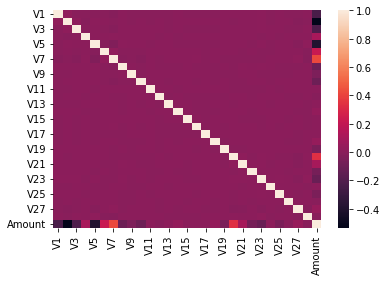

In [110]:
import seaborn as sns 
sns.heatmap(X_train.corr())

Посмотрим на распределение признака "Amount" (суммы перевода)

In [111]:
df[['Amount', 'Class']].groupby('Class').describe()

Amount                                                            
          count        mean         std  min   25%    50%     75%       max
Class                                                                      
0      284315.0   88.291022  250.105092  0.0  5.65  22.00   77.05  25691.16
1         492.0  122.211321  256.683288  0.0  1.00   9.25  105.89   2125.87

In [112]:
import plotly.express as px

fig = px.histogram(df, x="Amount")
fig.show()

Очевидно, данный признак нужно как-то преобразовать. Попробуем разные способы:

In [113]:
#Прологарифмируем

fig = px.histogram(np.log((df[df.Amount != 0])['Amount']), x="Amount")
fig.show()

Для того, чтобы успешно прологарифмировать признак Amount мне пришлось удалить строки с нулевой суммой перевода.
(Я не нашёл другого способа)

In [114]:
df_2 = df.copy()
df_2 = df_2[df_2.Amount != 0]

df_2['Amount'] = np.log((df_2[df_2.Amount != 0])['Amount'])
df_2['Amount'].min()

X = df_2.drop(columns=['Class', 'Time'])
y = df_2['Class']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

log_reg.fit(X_train, y_train)
y_pred_logreg = log_reg.predict(X_test)

print('Полученные значения для модели Логистической регрессии:')
print('Precision:', precision_score(y_test, y_pred_logreg))

print('Посмотрим также что произошло с recall:')
print(recall_score(y_test, y_pred_logreg))



Полученные значения для модели Логистической регрессии:
Precision: 0.9358974358974359
Посмотрим также что произошло с recall:
0.5934959349593496


Значение Precision заметно повысилось. (однако recall немного упал)

2) Z-score

In [115]:
from sklearn.preprocessing import StandardScaler

In [116]:
X = df.drop(columns=['Class', 'Time'])
X_scaled = StandardScaler().fit_transform(X)

y = df['Class']
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.3, random_state=42)

log_reg.fit(X_train, y_train)
y_pred_logreg = log_reg.predict(X_test)

print('Полученные значения для модели Логистической регрессии:')
print('Precision:', precision_score(y_test, y_pred_logreg))

print('Посмотрим также что произошло с recall:')
print(recall_score(y_test, y_pred_logreg))

Полученные значения для модели Логистической регрессии:
Precision: 0.8762886597938144
Посмотрим также что произошло с recall:
0.625


Значения метрик совсем немного изменились в худшую сторону

3) Min Max Scaling

In [117]:
from sklearn.preprocessing import MinMaxScaler
X = df.drop(columns=['Class', 'Time'])
X_scaled = MinMaxScaler().fit_transform(X)

y = df['Class']
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.3, random_state=42)

log_reg.fit(X_train, y_train)
y_pred_logreg = log_reg.predict(X_test)

print('Полученные значения для модели Логистической регрессии:')
print('Precision:', precision_score(y_test, y_pred_logreg))

print('Посмотрим также что произошло с recall:')
print(recall_score(y_test, y_pred_logreg))


Полученные значения для модели Логистической регрессии:
Precision: 0.8470588235294118
Посмотрим также что произошло с recall:
0.5294117647058824


Значения метрик снизились

Вывод: нормализация всего датасета привела к снижению метрик. А вот логарифмирование отдельного признака "Amount" повысило Precision.

Преобразованный датасет (с удалённым "Time" и прологарифмированным "Amount"):

In [118]:
df = df_2
df = df.drop(columns=['Time'])
df

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,5.008099,0
1,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,0.989541,0
2,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,5.936639,0
3,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,4.816241,0
4,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,4.248352,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284802,-11.881118,10.071785,-9.834783,-2.066656,-5.364473,-2.606837,-4.918215,7.305334,1.914428,4.356170,...,0.213454,0.111864,1.014480,-0.509348,1.436807,0.250034,0.943651,0.823731,-0.261365,0
284803,-0.732789,-0.055080,2.035030,-0.738589,0.868229,1.058415,0.024330,0.294869,0.584800,-0.975926,...,0.214205,0.924384,0.012463,-1.016226,-0.606624,-0.395255,0.068472,-0.053527,3.210440,0
284804,1.919565,-0.301254,-3.249640,-0.557828,2.630515,3.031260,-0.296827,0.708417,0.432454,-0.484782,...,0.232045,0.578229,-0.037501,0.640134,0.265745,-0.087371,0.004455,-0.026561,4.217741,0
284805,-0.240440,0.530483,0.702510,0.689799,-0.377961,0.623708,-0.686180,0.679145,0.392087,-0.399126,...,0.265245,0.800049,-0.163298,0.123205,-0.569159,0.546668,0.108821,0.104533,2.302585,0


Перебор гиперпараметров для логистической регрессии:

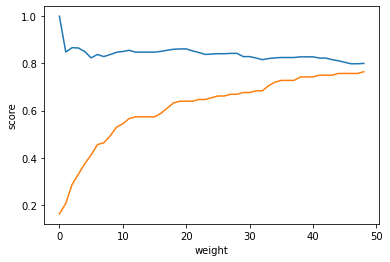

In [119]:
precision_list = []
recall_list = []

X = df.drop(columns=['Class'])
y = df['Class']

for weight in range(1, 50):
    log_reg = LogisticRegression(class_weight={0: 1, 1: weight/10}, max_iter=1000)

    log_reg.fit(X_train, y_train)
    y_pred_logreg = log_reg.predict(X_test)

    precision_list.append(precision_score(y_test, y_pred_logreg))
    recall_list.append(recall_score(y_test, y_pred_logreg))
    
plt.plot(precision_list)    
plt.plot(recall_list)
plt.xlabel('weight')
plt.ylabel('score')
plt.show()

С увеличением веса мошеннических транзакций уменьшается precision. Однако, когда вес мошеннической транзакции < 1, precision хоть и больше, но recall заметно падает.
Поэтому оставим вес для обоих классов равный 1

Уберём penalty:

In [46]:
log_reg = LogisticRegression(penalty='none', max_iter=1000)

log_reg.fit(X_train, y_train)
y_pred_logreg = log_reg.predict(X_test)

print('Полученные значения для модели Логистической регрессии:')
print('Precision:', precision_score(y_test, y_pred_logreg))

print('Посмотрим также что произошло с recall:')
print(recall_score(y_test, y_pred_logreg))

Полученные значения для модели Логистической регрессии:
Precision: 0.9358974358974359
Посмотрим также что произошло с recall:
0.5934959349593496


Значения метрик не изменились

Теперь посмотрим на значение метрик на KNN и переберём параметр n_neighbors:

In [11]:
from sklearn.neighbors import KNeighborsClassifier 

In [12]:
import matplotlib.pyplot as plt

In [ ]:
precision_list = []
recall_list = []

X = df.drop(columns=['Class'])
y = df['Class']

for i in range(3, 10):
    knn = KNeighborsClassifier(n_neighbors=i)

    knn.fit(X_train, y_train)
    y_pred_knn = knn.predict(X_test)

    precision_list.append(precision_score(y_test, y_pred_knn))
    recall_list.append(recall_score(y_test, y_pred_knn))
    
plt.plot(precision_list)    
plt.plot(recall_list)
plt.show()

Я, к сожалению, не дождался завершения выполнения этой ячейки... 

Поэтому итоговое значение метрики precision на модели логистической регрессии = 0.936

А на KNN precision score равен 1 без перебора параметров (я изначально указал n_neighbors = 5)

# 2 - Небинарная классификация на вашем датасете (суммарно 6 баллов)

### (2 балла) Выберите какой-нибудь интересный вам датасет, скачайте его и считайте данные

Творческое задание - найти в интернете (или собрать свой даже) датасет, сохранить его в файл, и загрузить сюда.

Требования:

- он должен быть немаленький (хотя бы 500 объектов, лучше больше)
- он должен быть интересный
- таргет должен быть небинарным классом

Минус балл, если ваш датасет с кем-нибудь повторится.

Ссылка на датасет:

https://www.kaggle.com/datasets/prathamtripathi/drug-classification

В выбранном мной датасете представлены данные о пациентах, лечившихся от одной и той же болезни. Каждый из них во время курса лечения применял один из препаратов ("Drug"). Задача: выяснить, какой препарат будет наиболее подходящим для будущего пациента.

In [120]:
df = pd.read_csv('drug200.csv')
df.head()

,Age,Sex,BP,Cholesterol,Na_to_K,Drug
0,23,F,HIGH,HIGH,25.355,DrugY
1,47,M,LOW,HIGH,13.093,drugC
2,47,M,LOW,HIGH,10.114,drugC
3,28,F,NORMAL,HIGH,7.798,drugX
4,61,F,LOW,HIGH,18.043,DrugY


In [121]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200 entries, 0 to 199
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Age          200 non-null    int64  
 1   Sex          200 non-null    object 
 2   BP           200 non-null    object 
 3   Cholesterol  200 non-null    object 
 4   Na_to_K      200 non-null    float64
 5   Drug         200 non-null    object 
dtypes: float64(1), int64(1), object(4)
memory usage: 9.5+ KB


3 из 5 признаков нечисловые. Посмотрим, категориальные ли они:

In [122]:
def find_cat(data, num_uniq=4):
    for name in data.columns:
        s = ''
        s += name
        if (type(data[name][0]) == str):
            s += ' строка,'
        if (data[name].nunique()<=num_uniq):
            s += ' мало уникальных'
        if (s!=name):
            print (s)
            
find_cat(df)

Sex строка, мало уникальных
BP строка, мало уникальных
Cholesterol строка, мало уникальных
Drug строка,


Как и предполагалось, признаки Sex, BP и Cholesterol - категориальные.
Так как они представляют собой строки, нужно их закодировать:

In [123]:
# Сначала закодируем target.
df["Drug"].value_counts()

DrugY    91
drugX    54
drugA    23
drugC    16
drugB    16
Name: Drug, dtype: int64

In [124]:
dct = {'DrugY': 1, 'drugX': 2 , 'drugA': 3, 'drugC': 4, 'drugB': 5}
df['Drug'] = df['Drug'].map(dct)
df.head()

,Age,Sex,BP,Cholesterol,Na_to_K,Drug
0,23,F,HIGH,HIGH,25.355,1
1,47,M,LOW,HIGH,13.093,4
2,47,M,LOW,HIGH,10.114,4
3,28,F,NORMAL,HIGH,7.798,2
4,61,F,LOW,HIGH,18.043,1


In [125]:
df["BP"].value_counts()

HIGH      77
LOW       64
NORMAL    59
Name: BP, dtype: int64

In [126]:
df["Cholesterol"].value_counts()

HIGH      103
NORMAL     97
Name: Cholesterol, dtype: int64

In [127]:
# Теперь с помощью One-hot encoding преобразуем остальные признаки
df_2 = pd.get_dummies(df)
df_2

,Age,Na_to_K,Drug,Sex_F,Sex_M,BP_HIGH,BP_LOW,BP_NORMAL,Cholesterol_HIGH,Cholesterol_NORMAL
0,23,25.355,1,1,0,1,0,0,1,0
1,47,13.093,4,0,1,0,1,0,1,0
2,47,10.114,4,0,1,0,1,0,1,0
3,28,7.798,2,1,0,0,0,1,1,0
4,61,18.043,1,1,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...
195,56,11.567,4,1,0,0,1,0,1,0
196,16,12.006,4,0,1,0,1,0,1,0
197,52,9.894,2,0,1,0,0,1,1,0
198,23,14.020,2,0,1,0,0,1,0,1


Посмотрим, есть ли пропуски в данных:

In [128]:
df_2.isna().sum()

Age                   0
Na_to_K               0
Drug                  0
Sex_F                 0
Sex_M                 0
BP_HIGH               0
BP_LOW                0
BP_NORMAL             0
Cholesterol_HIGH      0
Cholesterol_NORMAL    0
dtype: int64

In [129]:
X = df_2.drop(columns=['Drug'])
y = df_2['Drug']

In [130]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

### (2 балла) Обучите несколько моделей, посмотрите на метрики.
Как модели точно возьмите LogisticRegression, KNN и константу, можете придумать еще какие-нибудь.

Как метрики точно возьмите accuracy, разные усреднения precision, recall и f1.

In [131]:
from sklearn.linear_model import LogisticRegression
log_reg = LogisticRegression(max_iter=1000)

log_reg.fit(X_train, y_train)
y_pred_logreg = log_reg.predict(X_test)

print('Полученные значения для модели Логистической регрессии:')
print('Accuracy:', accuracy_score(y_test, y_pred_logreg))
print('Precision:', precision_score(y_test, y_pred_logreg, average='macro'))
print('Recall:', recall_score(y_test, y_pred_logreg, average='macro'))
print('F1:', f1_score(y_test, y_pred_logreg, average='macro'))
log_reg_scores = [round(accuracy_score(y_test, y_pred_logreg), 4), round(precision_score(y_test, y_pred_logreg, average='macro'), 4), 
                  round(recall_score(y_test, y_pred_logreg, average='macro'), 4), round(f1_score(y_test, y_pred_logreg, average='macro'), 4)]

Полученные значения для модели Логистической регрессии:
Accuracy: 0.9666666666666667
Precision: 0.9199999999999999
Recall: 0.9811965811965813
F1: 0.9403641456582633


За константу для таргета я решил взять "1" (DrugY) так как это самый большой по численности класс.

In [132]:
y_pred_const = np.ones(len(X_test))

print('Полученные значения для модели Логистической регрессии:')
print('Accuracy:', accuracy_score(y_test, y_pred_const))
print('Precision:', precision_score(y_test, y_pred_const, average='macro'))
print('Recall:', recall_score(y_test, y_pred_const, average='macro'))
print('F1:', f1_score(y_test, y_pred_const, average='macro'))

const_scores = [round(accuracy_score(y_test, y_pred_const), 4), round(precision_score(y_test, y_pred_const, average='macro'), 4), 
                  round(recall_score(y_test, y_pred_const, average='macro'), 4), round(f1_score(y_test, y_pred_const, average='macro'), 4)]

Полученные значения для модели Логистической регрессии:
Accuracy: 0.43333333333333335
Precision: 0.08666666666666667
Recall: 0.2
F1: 0.12093023255813953


In [133]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(X_train, y_train)
y_pred_knn = knn.predict(X_test)

print('Полученные значения для модели Логистической регрессии:')
print('Accuracy:', accuracy_score(y_test, y_pred_knn))
print('Precision:', precision_score(y_test, y_pred_knn, average='macro'))
print('Recall:', recall_score(y_test, y_pred_knn, average='macro'))
print('F1:', f1_score(y_test, y_pred_knn, average='macro'))

knn_scores = [round(accuracy_score(y_test, y_pred_knn), 4), round(precision_score(y_test, y_pred_knn, average='macro'), 4), 
                  round(recall_score(y_test, y_pred_knn, average='macro'), 4), round(f1_score(y_test, y_pred_knn, average='macro'), 4)]

Полученные значения для модели Логистической регрессии:
Accuracy: 0.7
Precision: 0.5983333333333333
Recall: 0.473015873015873
F1: 0.4714285714285714


In [134]:
score_df = pd.DataFrame([log_reg_scores, const_scores, knn_scores], 
                        columns=['accuracy','precision', 'recall', 'f1'], index=['log_reg', 'const', 'knn'])
score_df

,accuracy,precision,recall,f1
log_reg,0.9667,0.9200,0.9812,0.9404
const,0.4333,0.0867,0.2000,0.1209
knn,0.7000,0.5983,0.4730,0.4714


Получившаяся таблица с метриками показывает, что лучше всего справляется логистическая регрессиия (очень высокая точность - accuracy и precision). KNN на порядок хуже (каждая метрика ниже на 20% в сравнение с лог.рег.). Метрики на константе, очевидно очень плохие и зависят от выбранного в качестве константы класса.

#### Я также решил посмотреть, как будут отличаться результаты если преобразовывать датасет, заменяя значения на числовые с помощью словаря, а не One-Hot encoding

In [135]:
df.head()

,Age,Sex,BP,Cholesterol,Na_to_K,Drug
0,23,F,HIGH,HIGH,25.355,1
1,47,M,LOW,HIGH,13.093,4
2,47,M,LOW,HIGH,10.114,4
3,28,F,NORMAL,HIGH,7.798,2
4,61,F,LOW,HIGH,18.043,1


In [136]:
dct_sex = {'F': 0, 'M': 1}
df['Sex'] = df['Sex'].map(dct_sex)
df.head()

,Age,Sex,BP,Cholesterol,Na_to_K,Drug
0,23,0,HIGH,HIGH,25.355,1
1,47,1,LOW,HIGH,13.093,4
2,47,1,LOW,HIGH,10.114,4
3,28,0,NORMAL,HIGH,7.798,2
4,61,0,LOW,HIGH,18.043,1


In [137]:
dct_bp = {'LOW': 0, 'NORMAL': 1 , 'HIGH': 2}
df['BP'] = df['BP'].map(dct_bp)
df.head()

,Age,Sex,BP,Cholesterol,Na_to_K,Drug
0,23,0,2,HIGH,25.355,1
1,47,1,0,HIGH,13.093,4
2,47,1,0,HIGH,10.114,4
3,28,0,1,HIGH,7.798,2
4,61,0,0,HIGH,18.043,1


In [138]:
dct_ch = {'NORMAL': 0, 'HIGH': 1}
df['Cholesterol'] = df['Cholesterol'].map(dct_ch)
df.head()

,Age,Sex,BP,Cholesterol,Na_to_K,Drug
0,23,0,2,1,25.355,1
1,47,1,0,1,13.093,4
2,47,1,0,1,10.114,4
3,28,0,1,1,7.798,2
4,61,0,0,1,18.043,1


In [139]:
X = df.drop(columns=['Drug'])
y = df['Drug']

In [140]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

array([[<AxesSubplot:title={'center':'Age'}>,
        <AxesSubplot:title={'center':'Sex'}>],
       [<AxesSubplot:title={'center':'BP'}>,
        <AxesSubplot:title={'center':'Cholesterol'}>],
       [<AxesSubplot:title={'center':'Na_to_K'}>, <AxesSubplot:>]],
      dtype=object)

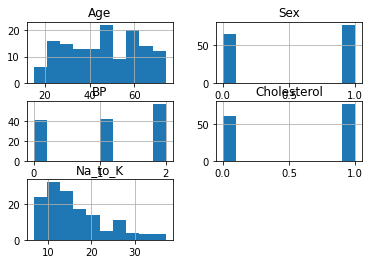

In [141]:
X_train.hist()

In [142]:
log_reg.fit(X_train, y_train)
y_pred_logreg = log_reg.predict(X_test)

print('Полученные значения для модели Логистической регрессии:')
print('Accuracy:', accuracy_score(y_test, y_pred_logreg))
print('Precision:', precision_score(y_test, y_pred_logreg, average='macro'))
print('Recall:', recall_score(y_test, y_pred_logreg, average='macro'))
print('F1:', f1_score(y_test, y_pred_logreg, average='macro'))

Полученные значения для модели Логистической регрессии:
Accuracy: 0.9
Precision: 0.9065217391304348
Recall: 0.8256410256410256
F1: 0.8002596160415385


In [143]:
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(X_train, y_train)
y_pred_knn = knn.predict(X_test)

print('Полученные значения для модели Логистической регрессии:')
print('Accuracy:', accuracy_score(y_test, y_pred_knn))
print('Precision:', precision_score(y_test, y_pred_knn, average='macro'))
print('Recall:', recall_score(y_test, y_pred_knn, average='macro'))
print('F1:', f1_score(y_test, y_pred_knn, average='macro'))

Полученные значения для модели Логистической регрессии:
Accuracy: 0.7166666666666667
Precision: 0.6507575757575758
Recall: 0.519047619047619
F1: 0.5238095238095238


Сравнив значения метрик, я понял, что One-Hot Encoding работает намного лучше на логистической регрессии и чуть хуже на KNN

Мне также стало интересно, какие значения покажут решающие деревья:

Из графика видно, что уже при глубине дерева равной 3 обе метрики равны 1.

Вернём датасет к One-Hot-Encoding:

In [144]:
X = df_2.drop(columns=['Drug'])
y = df_2['Drug']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
X.head()

,Age,Na_to_K,Sex_F,Sex_M,BP_HIGH,BP_LOW,BP_NORMAL,Cholesterol_HIGH,Cholesterol_NORMAL
0,23,25.355,1,0,1,0,0,1,0
1,47,13.093,0,1,0,1,0,1,0
2,47,10.114,0,1,0,1,0,1,0
3,28,7.798,1,0,0,0,1,1,0
4,61,18.043,1,0,0,1,0,1,0


### (2 балла) Выберите метрику, которую вы хотите максимизировать. Переберите гиперпараметры, постарайтесь найти модель, которая максимизирует эту метрику.

Обоснуйте свой выбор. Напишите красивый отчет с графиками. Добились ли вы результатов, которых хотели добиться для этого датасета?

По моему мнению, в таком случае (мультиклассовой классификации) нужно максимизировать метрику f1, так как с одной стороны нужно уменьшать false positive (чтобы не прописать пациенту ненужное ему лекарство), а с другой стороны нужно и "никого не забыть" (то есть максимизировать полноту).

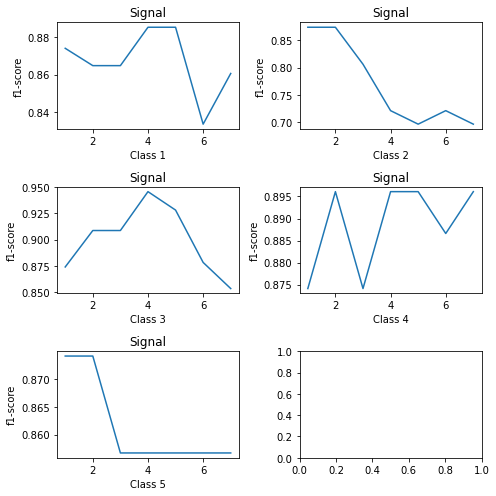

In [145]:

f1_list = []
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(7, 7))
for clss in range(1, 6):
    f1_list = []
    for weight in range(0, 7):
        log_reg = LogisticRegression(class_weight={clss: weight+1})

        log_reg.fit(X_train, y_train)
        y_pred_logreg = log_reg.predict(X_test)

        f1_list.append(round(f1_score(y_test, y_pred_logreg, average='macro'), 4))

    axs[(clss-1)//2, (clss-1)%2 ].set_title("Signal")
    axs[(clss-1)//2, (clss-1)%2].plot(list(range(1, 8)), f1_list, color='C0')
    axs[(clss-1)//2, (clss-1)%2].set_xlabel(f"Class {clss}")
    axs[(clss-1)//2, (clss-1)%2].set_ylabel("f1-score")

fig.tight_layout()
plt.show()

Так как для логистической регрессии необходимо перебрать параметр weight, а у нас несколько классов -> я перебрал этот параметр для каждого класса.
Оптимальные веса:

* для класса 1: 4
* для класса 2: 1 
* для класса 3: 4
* для класса 4: 2 или 4
* для класса 5: 1 или 2

Посмотрим какой будет f1, если применять эти веса одновременно:
    

In [146]:
log_reg = LogisticRegression(class_weight={1: 4, 2: 1, 3: 4, 4: 2, 5: 1})

log_reg.fit(X_train, y_train)
y_pred_logreg = log_reg.predict(X_test)

print('f1 = ', round(f1_score(y_test, y_pred_logreg, average='macro'), 4))

f1 =  0.9362


F1-score сильно повысился (без изменения весов он был 0.8).

Перебор параметр n_neighbors для knn

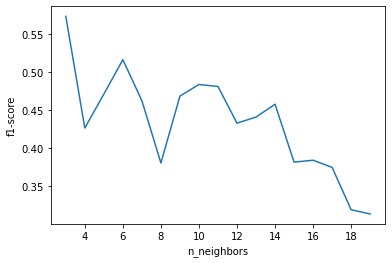

In [147]:
f1_list = []

for i in range(3, 20):
    knn = KNeighborsClassifier(n_neighbors=i)

    knn.fit(X_train, y_train)
    y_pred_knn = knn.predict(X_test)

    f1_list.append(f1_score(y_test, y_pred_knn, average='macro'))
    
plt.plot(range(3, 20), f1_list)
plt.xlabel('n_neighbors')
plt.ylabel('f1-score')
plt.show()

Из графика видно, что наилучшее значение для n_neighbors = 3, однако при любых значениях этого гиперпараметра f1-score очень плохой по сравнению с лог. регрессией.

Мне также стало интересно, какие значения покажут решающие деревья:

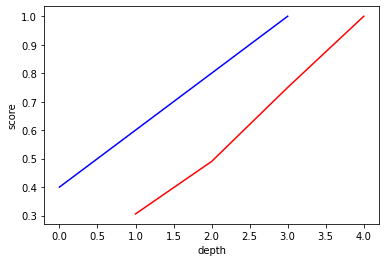

In [148]:
from sklearn.tree import DecisionTreeClassifier

precision_list = []
recall_list = []
for depth in range(1, 5):
    clf = DecisionTreeClassifier(max_depth=depth, random_state=42)
    clf.fit(X_train, y_train)

    y_pred_tree = clf.predict(X_test)

    precision_list.append(precision_score(y_test, y_pred_tree, average='macro'))
    recall_list.append(recall_score(y_test, y_pred_tree, average='macro'))

plt.plot(range(1, 5), precision_list, color='r')    
plt.plot(recall_list, color='b')
plt.xlabel('depth')
plt.ylabel('score')
plt.show()

Из графика видно, что уже при глубине дерева равной 3 обе метрики (и precision и recall) равны 1.

Вывод:
* я считаю, что результаты на логистической регрессии после подбора гиперпараметров очень хорошие.
* на KNN мне не удалось улучшить метрику.
* Константа ожидаемо показала плохие результаты
* Решающие деревья показывают также очень хорошие результаты, а при увеличении глубины дерева метрики вообще равны = 1